### Identifying best method to normalize CycIF TMA data

#### Load Libraries

In [1]:
# Import librarires
import pandas as pd
import numpy as np
import os
#import seaborn as sns; sns.set(style="white", color_codes=True, rc={'figure.figsize':(20,15)})
import seaborn as sns; sns.set(style="white", color_codes=True)
import matplotlib.pyplot as plt

#import community
#import networkx as nx

# Import custom functions
import wget

# Create anndata and scanpy
import anndata as ad
import scanpy as sc
import scanpy.external as sce

sc.set_figure_params(scanpy=True, dpi=180, dpi_save=300, frameon=True, vector_friendly=True, color_map=None, format='pdf', transparent=False, ipython_format='png2x')

#### Set Working Directory

In [2]:
# Laptop
#WD = "/Users/aj/Dropbox (Partners HealthCare)/Data/Vignesh_Lymphoma_tma/03252019_Datadump/"
#WD = "/Users/aj/Dropbox (Partners HealthCare)/Data/Vignesh_Lymphoma_tma/20190214_Datadump/"
# HMS
WD = "C:/Users/ajn16/Dropbox (Partners HealthCare)/Data/Vignesh_Lymphoma_tma/03252019_Datadump/"
os.chdir(WD)

#### Load Data

In [6]:
# Load Data
adata = sc.read("atcl.h5ad")

In [ ]:
sc.pp.filter_cells(adata, min_genes=27)

In [ ]:
adata = adata[adata.obs['Disease'] == "Angioimmunoblastic Cell Lymphoma"]
adata

In [20]:
j = pd.DataFrame(adata.X)

In [21]:
# Calculate total count for each cell
sum = j.sum(axis=1)

In [23]:
# Divide genes by total count for every cell
j_new = j.div(sum, axis=0)

In [28]:
# Calculate median count of the entire dataset
med = j.median().median()

In [29]:
# Multiply by scaling fator (median count of entire dataset)
j_new = j_new*med

In [32]:
# Replace adata matrix
adata.X = j_new.values

In [34]:
adata

View of AnnData object with n_obs × n_vars = 49576 × 27 
    obs: 'core', 'Disease', 'StudyID', 'patient', 'n_genes'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [35]:
# Covert patient column into string 
adata.obs['patient'] = adata.obs['patient'].astype(str)
adata.obs['core'] = adata.obs['core'].astype(str)

In [36]:
sc.pp.log1p(adata)
#adata.raw = adata

In [10]:
# Load identified cell type by the cell calling algorithm
cell_type = pd.read_csv('cell_type_atcl.csv', dtype={'marker': str})
cell_type_modified = pd.read_csv('cell_type_modified_atcl.csv', dtype={'marker': str})
cell_type.head()

,Unnamed: 0,Level 1,Level 2,Level 3,Level 4,Level 5
0,109_4,other,NaN,NaN,NaN,NaN
1,109_7,immune cells,T cells,Gamma Delta T cells,NaN,NaN
2,109_10,immune cells,T cells,Gamma Delta T cells,NaN,NaN
3,109_11,immune cells,Macrophages,NaN,M1 macrophages,NaN
4,109_13,other,NaN,NaN,NaN,NaN


In [11]:
adata.obs['Level 1'] = cell_type['Level 1'].values
adata.obs['Level 2'] = cell_type['Level 2'].values
adata.obs['Level 3'] = cell_type['Level 3'].values
adata.obs['Level 4'] = cell_type['Level 4'].values
adata.obs['Level 5'] = cell_type['Level 5'].values

In [12]:
adata.obs['Level 1'].head()

index
109_4            other
109_7     immune cells
109_10    immune cells
109_11    immune cells
109_13           other
Name: Level 1, dtype: object

In [42]:
#core_id = pd.DataFrame(adata.obs['core'])
#core_id.to_csv("atcl_coreid.csv", sep=',')

In [43]:
#d = pd.DataFrame(adata.X, index = adata.obs.index, columns=adata.var.index)
#d.to_csv("atcl.csv", sep=',')

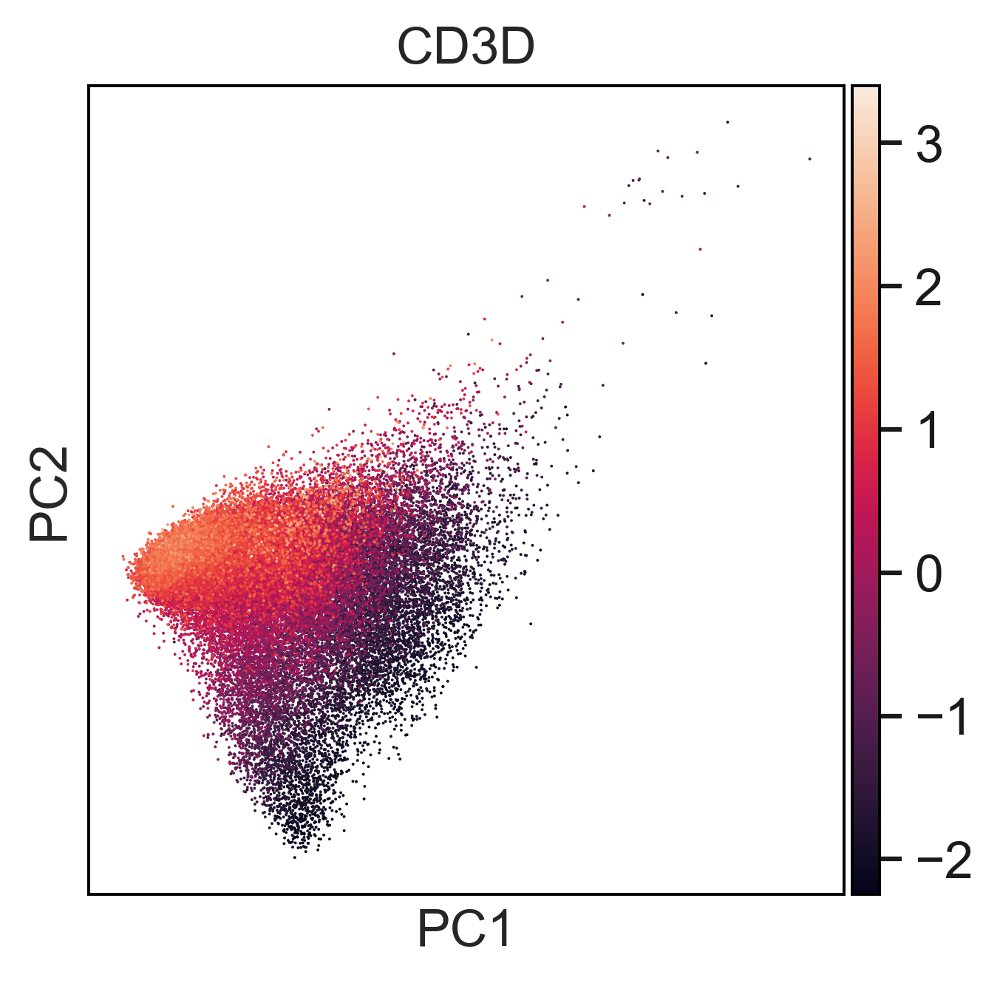

In [64]:
sc.tl.pca(adata, svd_solver='arpack')
#sc.pl.pca(adata, color='CD3D',color_map="RdBu_r", components='1,2')
sc.pl.pca(adata, color='CD3D')

In [66]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=7)

In [ ]:
#sc.tl.draw_graph(adata)
#sc.pl.draw_graph(adata, color=['CD20', 'CD3D', 'CD68'], color_map="RdBu_r")

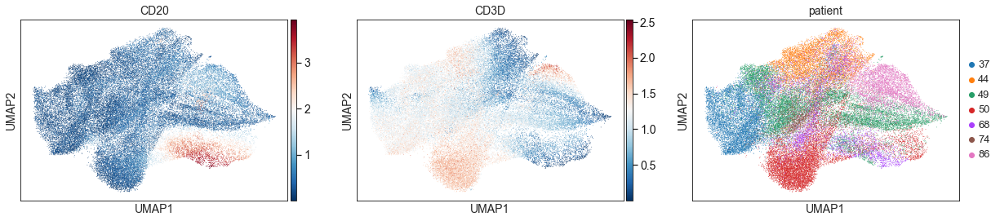

In [40]:
sc.tl.umap(adata)
sc.pl.umap(adata, color=['CD20', 'CD3D', 'patient'], color_map="RdBu_r")

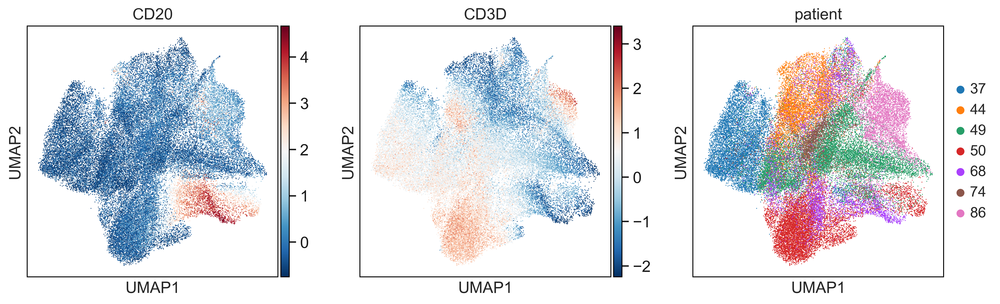

In [67]:
sc.tl.umap(adata)
sc.pl.umap(adata, color=['CD20', 'CD3D', 'patient'], color_map="RdBu_r")

In [68]:
sc.tl.leiden(adata, resolution=0.5)

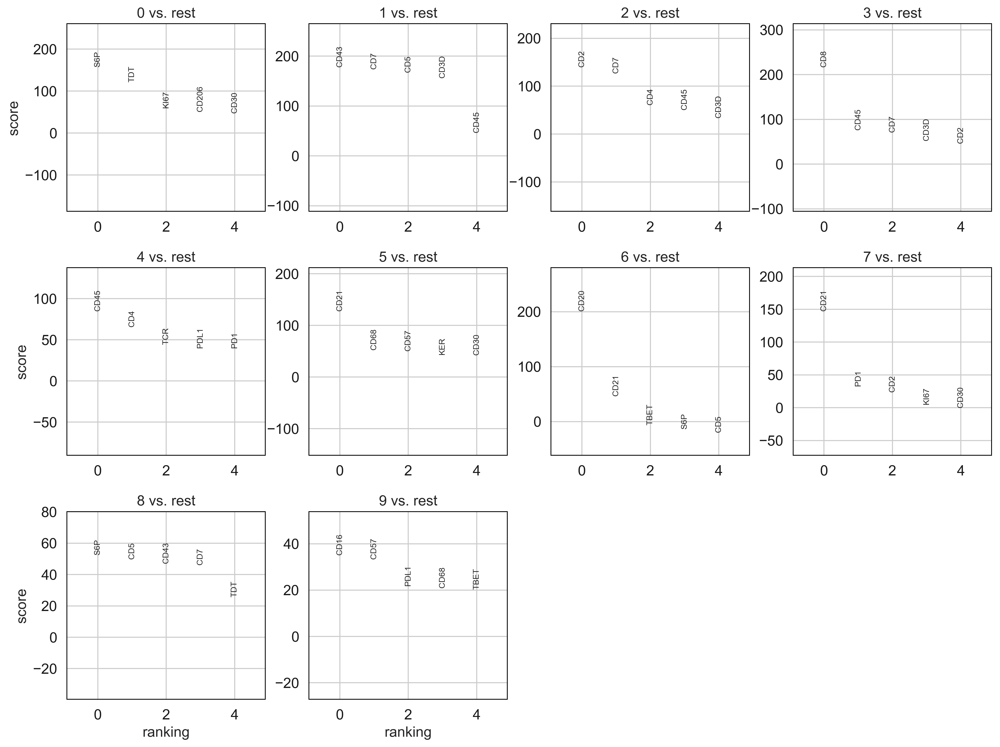

In [48]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=5, sharey=False)

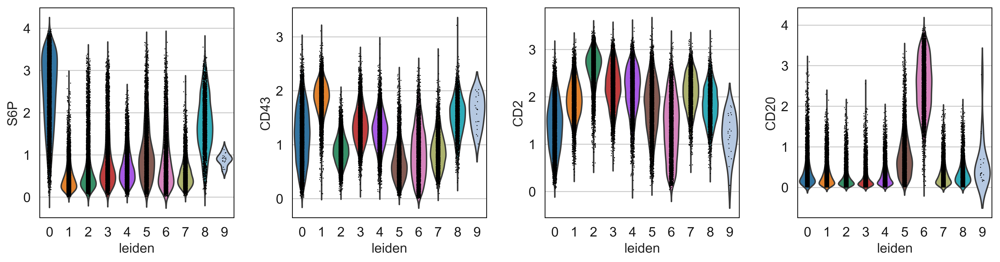

In [49]:
sc.pl.violin(adata, ['S6P', 'CD43', 'CD2', 'CD20'], groupby='leiden')

In [63]:
# Scale data
sc.pp.scale(adata)

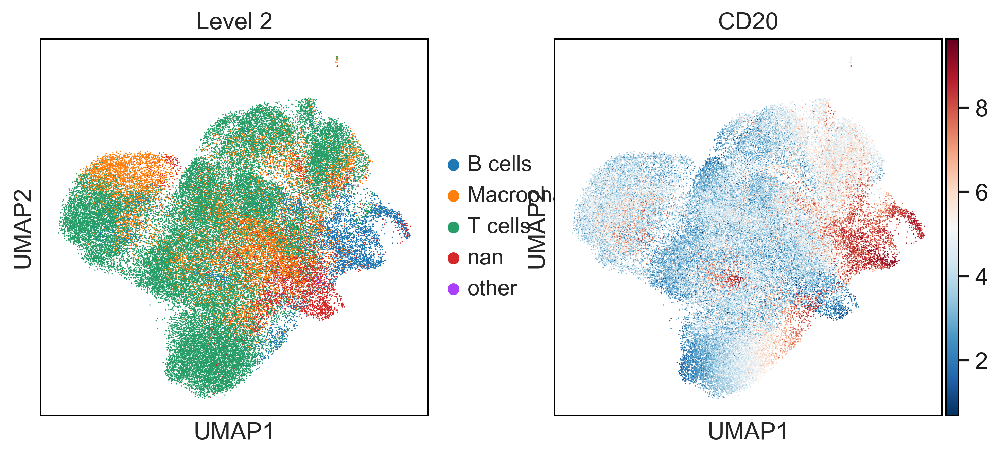

In [29]:
sc.pl.umap(adata, color=['Level 2', 'CD20'], color_map="RdBu_r")

In [170]:
# Write Data
adata.write("atcl1.h5ad")

In [17]:
# custom normalization
file_url = 'https://raw.githubusercontent.com/ajitjohnson/Jupyter-Notebooks/master/py_scripts/mi_pp_normalize.py'
exec(open(wget.download(file_url)).read())
dd = mi_pp_normalize (d1)

100% [..................................................................................] 655 / 655Applying log transformation and quantile normalization...


In [14]:
# Load identified cell type by the cell calling algorithm
norm_data = pd.read_csv('data_normalized_atcl.csv', delimiter=',', index_col=0)
norm_data.head()

,CD2,TCR,CD4,CD3D,CD7,CD43,ALK,CD45,KI67,CD5,...,KER,PD1,CD206,CD21,S6P,TBET,TDT,CD31,CD16,PSTAT3
109_4,-5.000000,-0.555556,-5.000000,-5.000000,-5.000000,-5.000000,-5.000000,-5.000000,-5.000000,-5.000000,...,-4.477612,-5.000000,-3.830188,-5.000000,-1.930331,-2.621860,-3.888889,-5.000000,-3.510199,-5.000000
109_7,1.141250,-5.000000,1.281660,0.245514,0.606710,0.686540,0.554605,1.560720,-5.000000,-0.555556,...,-4.736698,-0.432736,-1.765747,0.761896,0.593105,-0.477494,-5.000000,-4.111755,-1.181531,-1.107646
109_10,2.125816,-5.000000,2.163359,2.004969,2.011964,0.692879,1.454108,1.912474,-0.743219,-1.666667,...,-4.477612,0.285078,-2.657862,1.007824,-0.700729,-1.025147,2.777778,-3.450431,-2.004444,0.780047
109_11,1.837622,-5.000000,2.344106,0.619166,0.908625,0.556100,1.264168,2.134974,-0.101463,0.555556,...,-4.736698,0.768207,-1.099205,1.781419,0.593105,-0.635274,-5.000000,-3.450431,-0.220887,0.899796
109_13,-5.000000,-5.000000,0.992841,-5.000000,-0.118206,-0.864014,-1.621270,-5.000000,-5.000000,-2.777778,...,-4.736698,-2.279447,-1.589068,-0.277122,-2.337123,-1.826810,0.555556,-3.253202,-0.963585,-0.549976


In [15]:
n_adata = adata

In [16]:
n_adata

AnnData object with n_obs × n_vars = 49576 × 27 
    obs: 'core', 'Disease', 'StudyID', 'patient', 'n_genes', 'Level 1', 'Level 2', 'Level 3', 'Level 4', 'Level 5'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [17]:
n_adata.X = norm_data.values

In [18]:
n_adata

AnnData object with n_obs × n_vars = 49576 × 27 
    obs: 'core', 'Disease', 'StudyID', 'patient', 'n_genes', 'Level 1', 'Level 2', 'Level 3', 'Level 4', 'Level 5'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [19]:
# Load identified cell type by the cell calling algorithm
cell_type = pd.read_csv('cell_type_atcl.csv', dtype={'marker': str})
cell_type_modified = pd.read_csv('cell_type_modified_atcl.csv', dtype={'marker': str})
cell_type.head()

,Unnamed: 0,Level 1,Level 2,Level 3,Level 4,Level 5
0,109_4,other,NaN,NaN,NaN,NaN
1,109_7,immune cells,T cells,Gamma Delta T cells,NaN,NaN
2,109_10,immune cells,T cells,Gamma Delta T cells,NaN,NaN
3,109_11,immune cells,Macrophages,NaN,M1 macrophages,NaN
4,109_13,other,NaN,NaN,NaN,NaN


In [20]:
n_adata.obs['Level 1'] = cell_type['Level 1'].values
n_adata.obs['Level 2'] = cell_type['Level 2'].values
n_adata.obs['Level 3'] = cell_type['Level 3'].values
n_adata.obs['Level 4'] = cell_type['Level 4'].values
n_adata.obs['Level 5'] = cell_type['Level 5'].values

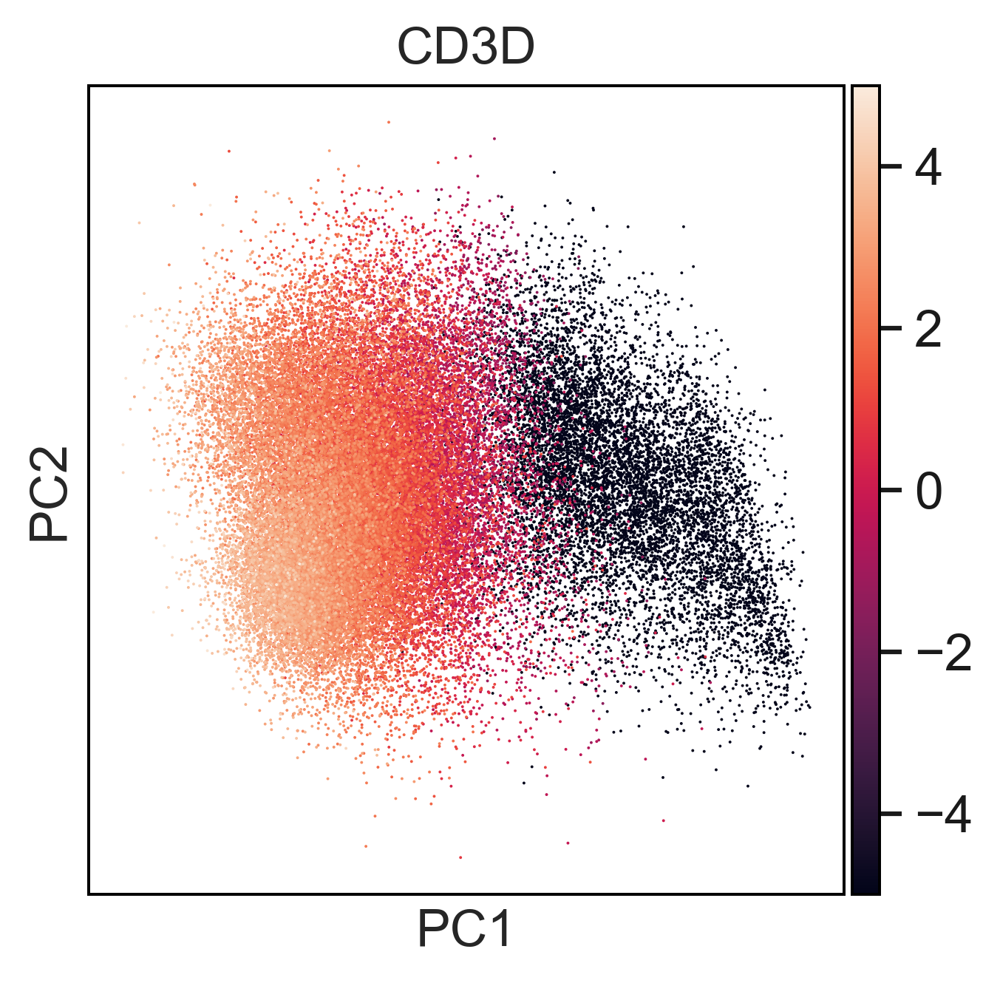

In [23]:
sc.tl.pca(n_adata, svd_solver='arpack')
#sc.pl.pca(adata, color='CD3D',color_map="RdBu_r", components='1,2')
sc.pl.pca(n_adata, color='CD3D')

In [27]:
sc.pp.neighbors(n_adata, n_neighbors=30, n_pcs=10)

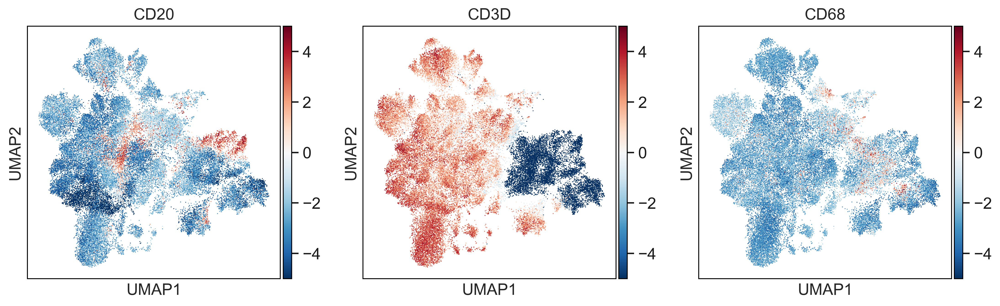

In [29]:
sc.tl.umap(n_adata)
sc.pl.umap(n_adata, color=["Level 2", 'CD20', 'CD3D', 'CD68'], color_map="RdBu_r")

# Write out data,meta,section for the core of interest

In [3]:
data = pd.read_csv('PTCLCycle1to9_CytMedian_nonorm.csv', delimiter=',', index_col=0)
meta = pd.read_csv('meta_new.csv', delimiter=',',index_col=0)
# Drop DPI channels
data = data.drop(list(data.filter(regex='DAPI|BACK', axis=1)), axis=1)
# Convert to adata
adata = ad.AnnData(data)
# Attach meta data with Anndata
adata.obs = meta

# Keep imp markers
columns = ["CD45","CD3D","CD2","CD5","CD43","CD7","CD20","CD68","CD163","CD56","CD21","CD4","CD8","CD206","PD1"]
remove = np.in1d(adata.var_names, columns)
bdata = adata[:, remove]

# Remove cells that do not express all markers
sc.pp.filter_cells(bdata, min_genes=15)
# Covert patient column into string 
bdata.obs['patient'] = bdata.obs['patient'].astype(str)
bdata.obs['core'] = bdata.obs['core'].astype(str)
bdata

AnnData object with n_obs × n_vars = 585011 × 15 
    obs: 'core', 'Disease', 'StudyID', 'patient', 'n_genes'

In [4]:
bdata.obs['Disease'].value_counts()

PTCL, NOS                                                                   106098
Control                                                                      92950
Angioimmunoblastic Cell Lymphoma                                             76775
TCL, Adult                                                                   73216
T Lymphoblastic Leukemia/ Lymphoma                                           59824
ALCL, ALK-                                                                   39827
Reative                                                                      36115
PTCL, B cell EBV-driven                                                      20448
T-Cell Prolymphocytic Leukemia                                               19554
Cutaneous TCL CD4- CD8-                                                      18126
Gamma/Delta T Cell Lymphproliferative Disorde                                14508
Angioimmunoblastic TCL + B cells  EBV-Driven                                 10276
PTCL

In [5]:
# Include all markers but only cells that express markers that are required to assign cell types
cdata = adata[bdata.obs.index,:]
# Remove other identified bad markers
columns = ['CD10', 'CD11B', "ALK"]
remove = np.in1d(cdata.var_names, columns)
cdata = cdata[:, ~remove]
cdata

View of AnnData object with n_obs × n_vars = 585011 × 32 
    obs: 'core', 'Disease', 'StudyID', 'patient'

In [6]:
# Subset into disease of interest
ddata = cdata[cdata.obs['Disease'] == "ALCL, ALK-"]
ddata

View of AnnData object with n_obs × n_vars = 39827 × 32 
    obs: 'core', 'Disease', 'StudyID', 'patient'

In [11]:
# write out data,meta,section for the core of interest
core_id = pd.DataFrame(ddata.obs['Disease'])
core_id.to_csv("runby.csv", sep=',')

d = pd.DataFrame(ddata.X, index = ddata.obs.index, columns=ddata.var.index)
d.to_csv("exp.csv", sep=',')

meta = pd.DataFrame(ddata.obs, index = ddata.obs.index)
meta.to_csv("meta.csv", sep=',')

## Analysing core-109

In [101]:
# Load Data
adata = sc.read("atcl.h5ad")
sc.pp.filter_cells(adata, min_genes=27)
adata = adata[adata.obs['core'] == "109"]
# Covert patient column into string 
adata.obs['patient'] = adata.obs['patient'].astype(str)
adata.obs['core'] = adata.obs['core'].astype(str)

In [102]:
n_adata = adata
sc.pp.log1p(n_adata)

In [103]:
# Load identified cell type by the cell calling algorithm
cell_type = pd.read_csv('cell_type_atcl_109.csv', dtype={'marker': str})
cell_type_modified = pd.read_csv('cell_type_modified_atcl.csv', dtype={'marker': str})

In [104]:
adata.obs['Level 1'] = cell_type['Level 1'].values
adata.obs['Level 2'] = cell_type['Level 2'].values
adata.obs['Level 3'] = cell_type['Level 3'].values
adata.obs['Level 4'] = cell_type['Level 4'].values
adata.obs['Level 5'] = cell_type['Level 5'].values

In [72]:
# Load identified cell type by the cell calling algorithm
#norm_data = pd.read_csv('data_normalized_atcl_109.csv', delimiter=',', index_col=0)
#adata.X = norm_data.values

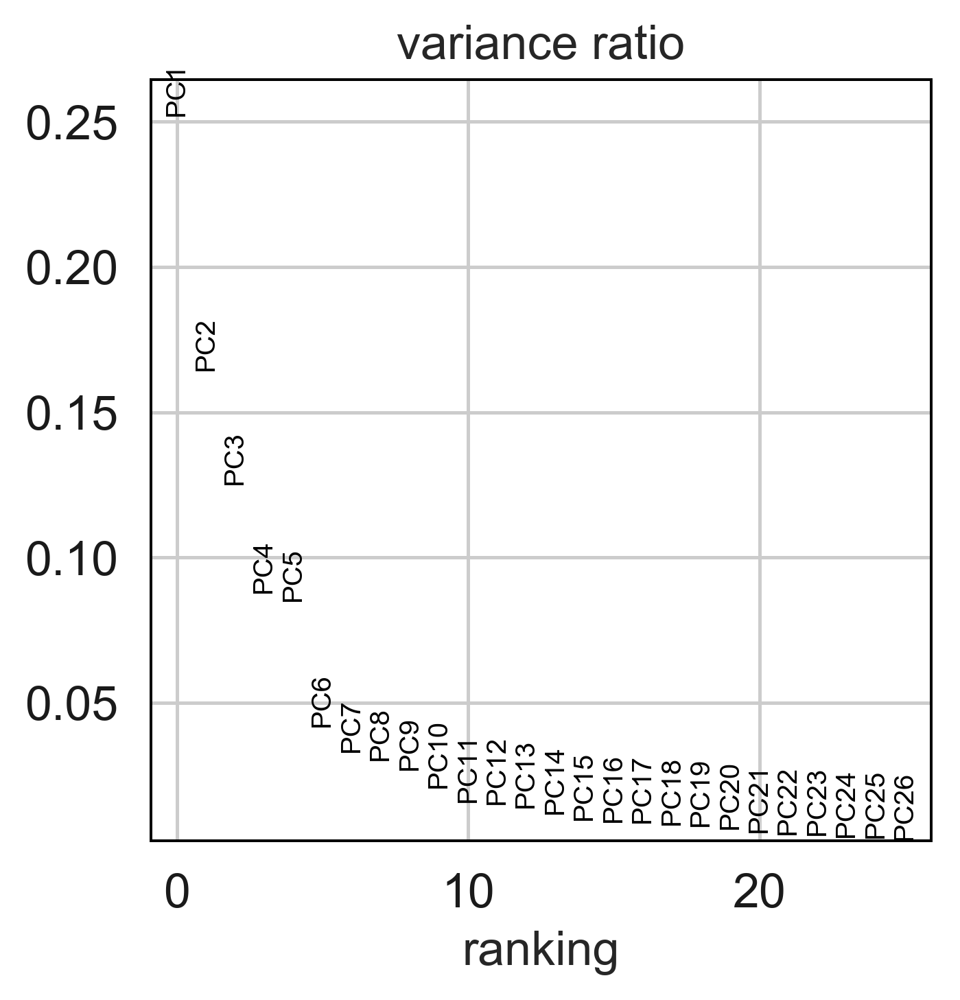

In [105]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)

In [79]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=10)

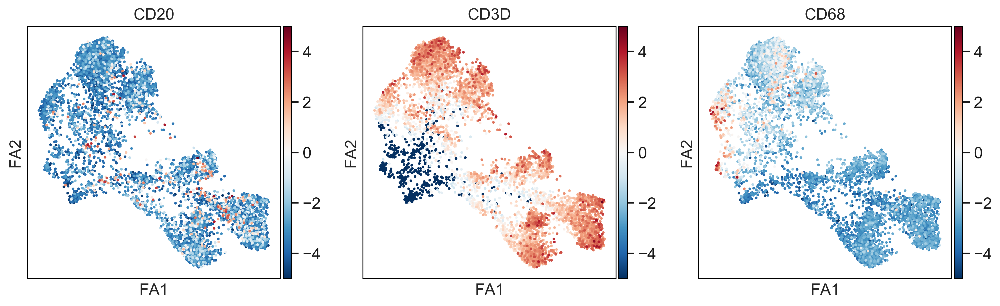

In [32]:
sc.tl.draw_graph(adata)
sc.pl.draw_graph(adata, color=['CD20', 'CD3D', 'CD68'], color_map="RdBu_r")

... storing 'core' as categorical
... storing 'patient' as categorical
... storing 'Level 1' as categorical
... storing 'Level 2' as categorical
... storing 'Level 3' as categorical
... storing 'Level 4' as categorical
... storing 'Level 5' as categorical


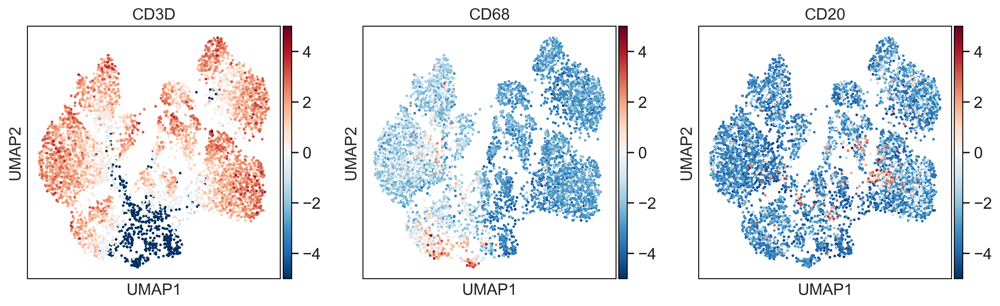

In [31]:
sc.tl.umap(adata)
sc.pl.umap(adata, color=['CD3D', 'CD68', 'CD20'], color_map="RdBu_r")

In [106]:
# Log data
sc.tl.pca(n_adata, svd_solver='arpack')
sc.pp.neighbors(n_adata, n_neighbors=30, n_pcs=10)

... storing 'core' as categorical
... storing 'patient' as categorical
... storing 'Level 1' as categorical
... storing 'Level 2' as categorical
... storing 'Level 3' as categorical
... storing 'Level 4' as categorical
... storing 'Level 5' as categorical


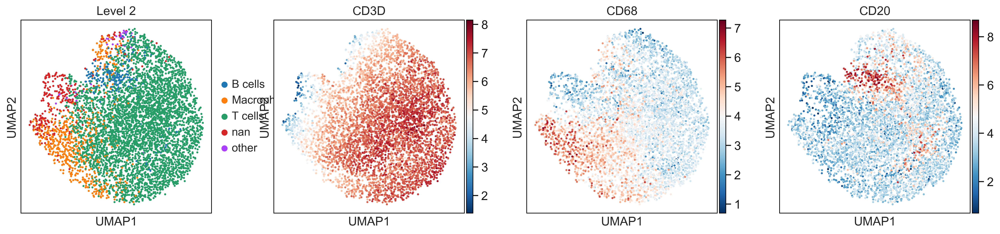

In [107]:
sc.tl.umap(n_adata)
sc.pl.umap(n_adata, color=["Level 2", 'CD3D', 'CD68', 'CD20'], color_map="RdBu_r")

saving figure to file ./figures/umap_Level-1.pdf


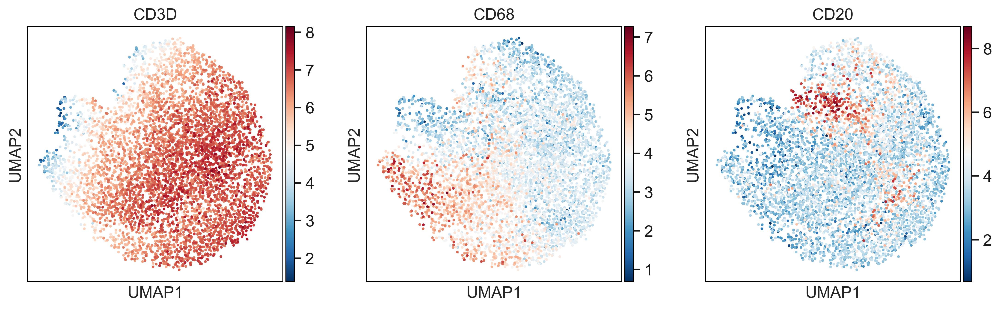

In [109]:
sc.pl.umap(n_adata, color=['CD3D', 'CD68', 'CD20'], color_map="RdBu_r", save = "_Level-1.pdf")

## Analysing core-3

In [125]:
# Load Data
adata = sc.read("atcl.h5ad")
sc.pp.filter_cells(adata, min_genes=27)
adata = adata[adata.obs['core'] == "2"]
# Covert patient column into string 
adata.obs['patient'] = adata.obs['patient'].astype(str)
adata.obs['core'] = adata.obs['core'].astype(str)
adata

AnnData object with n_obs × n_vars = 3150 × 27 
    obs: 'core', 'Disease', 'StudyID', 'patient', 'n_genes'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

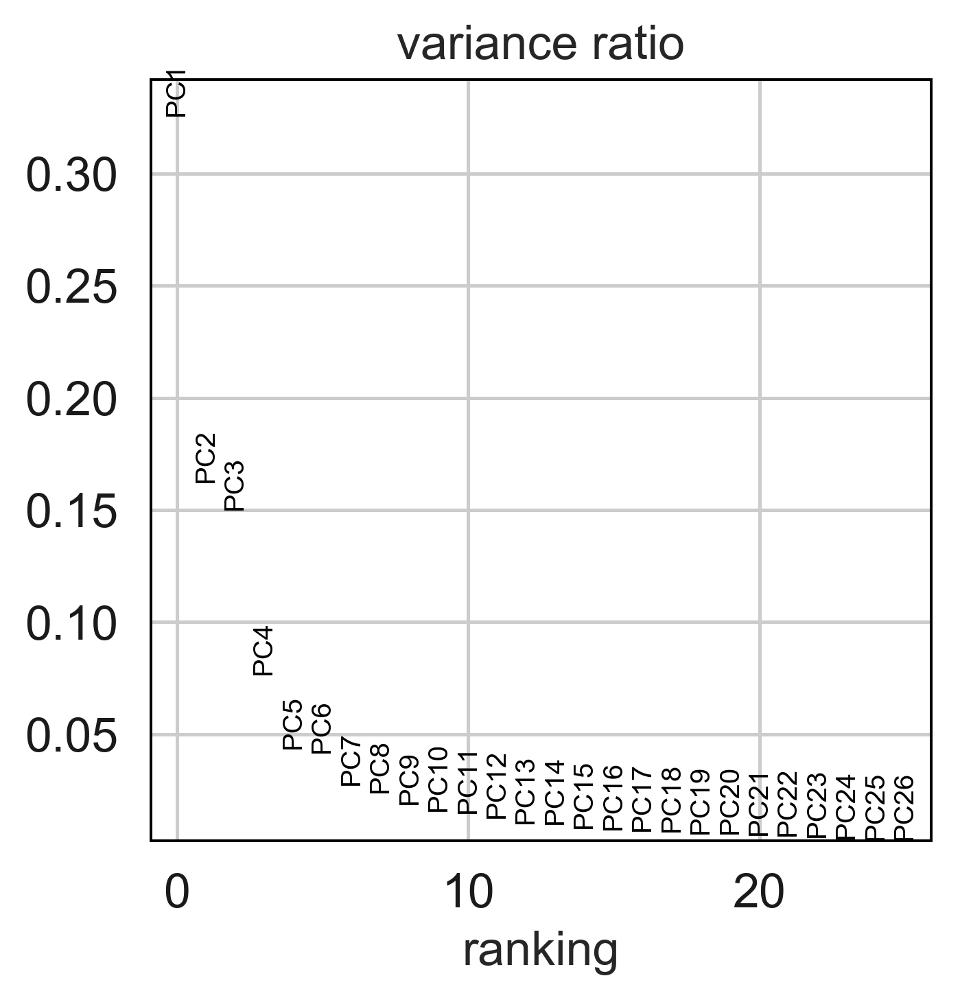

In [133]:
n_adata = adata
sc.pp.log1p(n_adata)

# Load identified cell type by the cell calling algorithm
cell_type = pd.read_csv('cell_type_3.csv', dtype={'marker': str})
cell_type_modified = pd.read_csv('cell_type_modified_3.csv', dtype={'marker': str})

adata.obs['Level 1'] = cell_type['Level 1'].values
adata.obs['Level 2'] = cell_type['Level 2'].values
adata.obs['Level 3'] = cell_type['Level 3'].values
adata.obs['Level 4'] = cell_type['Level 4'].values
adata.obs['Level 5'] = cell_type['Level 5'].values

sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)

In [134]:
sc.pp.neighbors(n_adata, n_neighbors=30, n_pcs=10)

... storing 'Level 1' as categorical
... storing 'Level 2' as categorical
... storing 'Level 3' as categorical
... storing 'Level 4' as categorical
... storing 'Level 5' as categorical


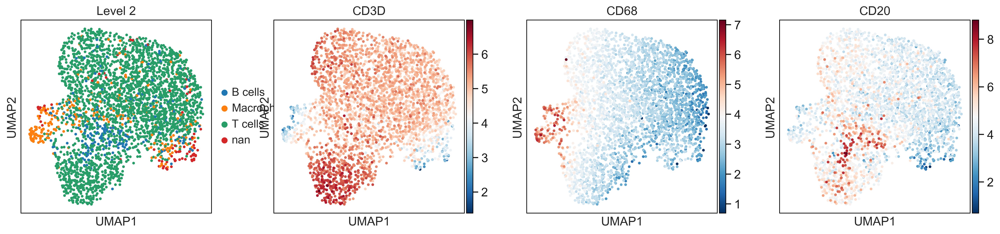

In [135]:
sc.tl.umap(n_adata)
sc.pl.umap(n_adata, color=["Level 2", 'CD3D', 'CD68', 'CD20'], color_map="RdBu_r")

# Analysing core 275

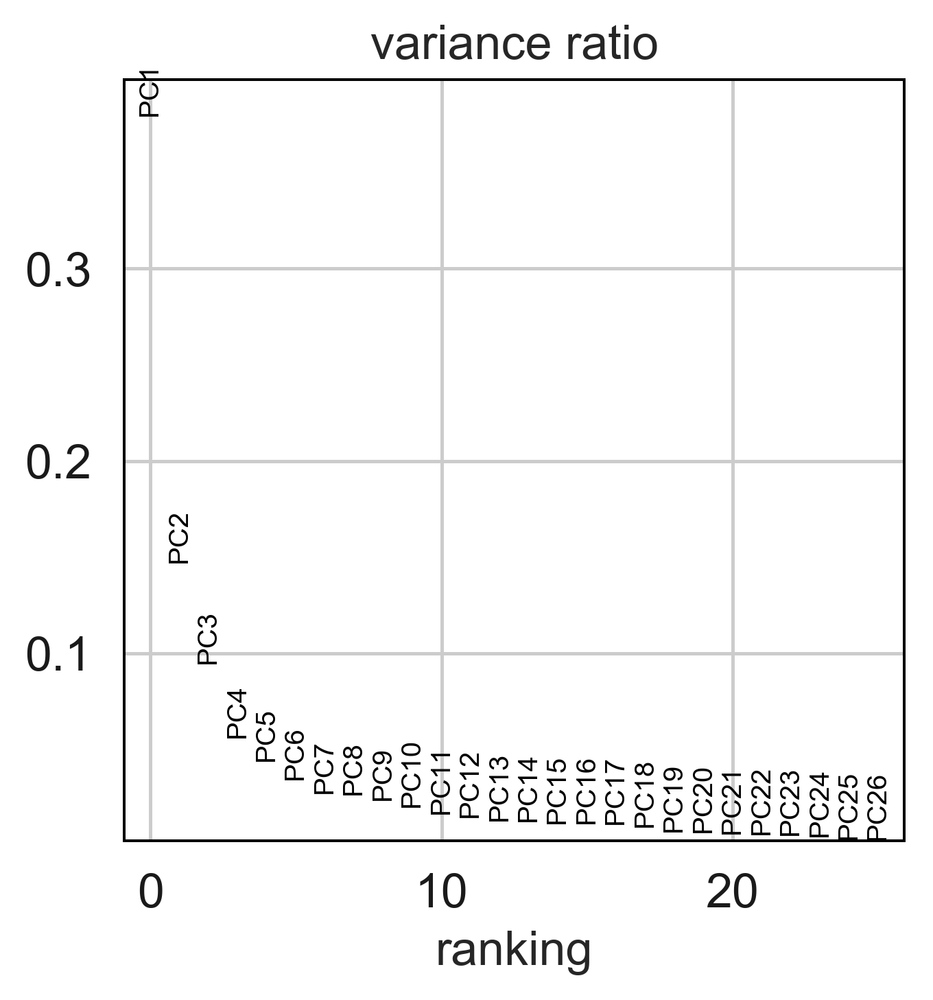

In [142]:
# Load Data
adata = sc.read("atcl.h5ad")
sc.pp.filter_cells(adata, min_genes=27)
adata = adata[adata.obs['core'] == "275"]
# Covert patient column into string 
adata.obs['patient'] = adata.obs['patient'].astype(str)
adata.obs['core'] = adata.obs['core'].astype(str)

n_adata = adata
sc.pp.log1p(n_adata)

# Load identified cell type by the cell calling algorithm
cell_type = pd.read_csv('cell_type_275.csv', dtype={'marker': str})
cell_type_modified = pd.read_csv('cell_type_modified_275.csv', dtype={'marker': str})

adata.obs['Level 1'] = cell_type['Level 1'].values
adata.obs['Level 2'] = cell_type['Level 2'].values
adata.obs['Level 3'] = cell_type['Level 3'].values
adata.obs['Level 4'] = cell_type['Level 4'].values
adata.obs['Level 5'] = cell_type['Level 5'].values

sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)

In [143]:
sc.pp.neighbors(n_adata, n_neighbors=30, n_pcs=10)

... storing 'core' as categorical
... storing 'patient' as categorical
... storing 'Level 1' as categorical
... storing 'Level 2' as categorical
... storing 'Level 3' as categorical
... storing 'Level 4' as categorical
... storing 'Level 5' as categorical


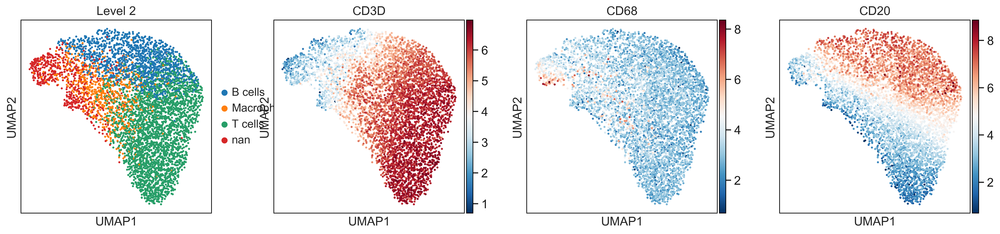

In [144]:
sc.tl.umap(n_adata)
sc.pl.umap(n_adata, color=["Level 2", 'CD3D', 'CD68', 'CD20'], color_map="RdBu_r")